# Functions

This notebook was directly adapted from ml/old/dataset_visualisation.ipynb

## Initialisation

In [7]:
import os

path = os.getcwd()
# find the string 'project' in the path, return index
index_project = path.find('project')
# slice the path from the index of 'project' to the end
project_path = path[:index_project+7]
# set the working directory
os.chdir(project_path)
print(f'Project path set to: {os.getcwd()}')


Project path set to: c:\Github\ode-biomarker-project


In [8]:
from PathLoader import PathLoader
path_loader = PathLoader('data_config.env', 'current_user.env')

In [9]:
from DataLink import DataLink
data_link = DataLink(path_loader, 'data_codes.csv')

# CCLE mRNA expression dataset

In [12]:
# load in data

import pandas as pd
import pickle

# import GDSC2 drug response data using pickle

with open(f'{path_loader.get_data_path()}data/drug-response/GDSC2/cache_gdsc2.pkl', 'rb') as f:
    gdsc2 = pickle.load(f)
    gdsc2_info = pickle.load(f)

# import CCLE gene expression data using pickle

with open(f'{path_loader.get_data_path()}data/gene-expression/CCLE_Public_22Q2/ccle_expression.pkl', 'rb') as f:
    gene_entrez = pickle.load(f)
    ccle = pickle.load(f)

# import CCLE sample info data using pickle

with open(f'{path_loader.get_data_path()}data/gene-expression/CCLE_Public_22Q2/ccle_sample_info.pkl', 'rb') as f:
    ccle_sample_info = pickle.load(f)


### Missing values analysis

In [13]:
# Missing values analysis for the CCLE gene expression matrix (analogue of the proteomics example)

# compute totals
total_missing_ccle = ccle.isna().sum().sum()
total_cells_ccle = ccle.size
pct_missing_ccle = total_missing_ccle / total_cells_ccle * 100

# per-column and per-row missing counts
missing_per_col_ccle = ccle.isna().sum()
missing_per_row_ccle = ccle.isna().sum(axis=1)

# summary prints
print(f"Total missing (CCLE): {total_missing_ccle} / {total_cells_ccle} ({pct_missing_ccle:.2f}%)\n")

print("Top 10 CCLE columns by missing count:")
top10_cols = missing_per_col_ccle.sort_values(ascending=False).head(10)
# include both counts and percent of column missing
top10_cols_pct = (top10_cols / ccle.shape[0] * 100).round(2)
for col, cnt in top10_cols.items():
    print(f"{col}: {cnt} missing ({top10_cols_pct.loc[col]}%)")
print()

print("Top 10 CCLE rows by missing count:")
top10_rows = missing_per_row_ccle.sort_values(ascending=False).head(10)
for idx, cnt in top10_rows.items():
    print(f"{idx}: {cnt} missing ({cnt / ccle.shape[1] * 100:.2f}%)")
print()

# completely missing columns / rows
completely_missing_cols = (missing_per_col_ccle == ccle.shape[0]).sum()
completely_missing_rows = (missing_per_row_ccle == ccle.shape[1]).sum()
print(f"Completely missing columns: {completely_missing_cols}")
print(f"Completely missing rows: {completely_missing_rows}\n")

# summary stats to assess distribution of missingness
print("Missing per-column summary (CCLE):")
print(missing_per_col_ccle.describe().to_string(), "\n")

print("Missing per-row summary (CCLE):")
print(missing_per_row_ccle.describe().to_string(), "\n")

# optional: show fraction of columns with >50% missing and >90% missing
frac_cols_gt50 = (missing_per_col_ccle > 0.5 * ccle.shape[0]).sum() / ccle.shape[1] * 100
frac_cols_gt90 = (missing_per_col_ccle > 0.9 * ccle.shape[0]).sum() / ccle.shape[1] * 100
print(f"Columns with >50% missing: {(missing_per_col_ccle > 0.5 * ccle.shape[0]).sum()} ({frac_cols_gt50:.2f}%)")
print(f"Columns with >90% missing: {(missing_per_col_ccle > 0.9 * ccle.shape[0]).sum()} ({frac_cols_gt90:.2f}%)")

Total missing (CCLE): 0 / 27026132 (0.00%)

Top 10 CCLE columns by missing count:
CDR1: 0 missing (0.0%)
CELLLINE: 0 missing (0.0%)
TSPAN6: 0 missing (0.0%)
TNMD: 0 missing (0.0%)
DPM1: 0 missing (0.0%)
SCYL3: 0 missing (0.0%)
AL441992.2: 0 missing (0.0%)
AL353579.1: 0 missing (0.0%)
AC008770.4: 0 missing (0.0%)
SPEGNB: 0 missing (0.0%)

Top 10 CCLE rows by missing count:
1405: 0 missing (0.00%)
0: 0 missing (0.00%)
1: 0 missing (0.00%)
2: 0 missing (0.00%)
3: 0 missing (0.00%)
4: 0 missing (0.00%)
5: 0 missing (0.00%)
6: 0 missing (0.00%)
7: 0 missing (0.00%)
8: 0 missing (0.00%)

Completely missing columns: 0
Completely missing rows: 0

Missing per-column summary (CCLE):
count    19222.0
mean         0.0
std          0.0
min          0.0
25%          0.0
50%          0.0
75%          0.0
max          0.0 

Missing per-row summary (CCLE):
count    1406.0
mean        0.0
std         0.0
min         0.0
25%         0.0
50%         0.0
75%         0.0
max         0.0 

Columns with >50% 

In [14]:
ccle.head()

,CELLLINE,TSPAN6,TNMD,DPM1,SCYL3,C1orf112,FGR,CFH,FUCA2,GCLC,...,H3C2,H3C3,AC098582.1,DUS4L-BCAP29,C8orf44-SGK3,ELOA3B,NPBWR1,ELOA3D,ELOA3,CDR1
0,ACH-001113,4.331992,0.000000,7.364397,2.792855,4.470537,0.028569,1.226509,3.042644,6.499686,...,2.689299,0.189034,0.201634,2.130931,0.555816,0.0,0.275007,0.0,0.0,0.000000
1,ACH-001289,4.566815,0.584963,7.106537,2.543496,3.504620,0.000000,0.189034,3.813525,4.221104,...,1.286881,1.049631,0.321928,1.464668,0.632268,0.0,0.014355,0.0,0.0,0.000000
2,ACH-001339,3.150560,0.000000,7.379032,2.333424,4.227279,0.056584,1.310340,6.687061,3.682573,...,0.594549,1.097611,0.831877,2.946731,0.475085,0.0,0.084064,0.0,0.0,0.042644
3,ACH-001538,5.085340,0.000000,7.154109,2.545968,3.084064,0.000000,5.868143,6.165309,4.489928,...,0.214125,0.632268,0.298658,1.641546,0.443607,0.0,0.028569,0.0,0.0,0.000000
4,ACH-000242,6.729145,0.000000,6.537607,2.456806,3.867896,0.799087,7.208381,5.569856,7.127014,...,1.117695,2.358959,0.084064,1.910733,0.000000,0.0,0.464668,0.0,0.0,0.000000


In [15]:
# get the average expression of each gene across all cell lines
gene_means = ccle.select_dtypes(include="number").mean()

In [16]:
mean_df = gene_means.reset_index()
mean_df.columns = ["gene", "mean_expression"]
mean_df.head()

,gene,mean_expression
0,TSPAN6,3.363532
1,TNMD,0.069776
2,DPM1,6.495860
3,SCYL3,2.366410
4,C1orf112,3.674362


In [17]:
# get the mean of the mean expressions
mean_of_means = mean_df['mean_expression'].mean()
print(f'Mean of mean expressions: {mean_of_means}')

# how many genes have mean expression greater than the mean of means
num_genes_above_mean = (mean_df['mean_expression'] > mean_of_means
).sum()
print(f'Number of genes with mean expression above the mean of means: {num_genes_above_mean}')

# below mean of means
num_genes_below_mean = (mean_df['mean_expression'] <= mean_of_means
).sum()
print(f'Number of genes with mean expression below or equal to the mean of means: {num_genes_below_mean}')

# max and min mean expression
max_mean_expression = mean_df['mean_expression'].max()
min_mean_expression = mean_df['mean_expression'].min()

print(f'Max mean expression: {max_mean_expression}')
print(f'Min mean expression: {min_mean_expression}')

# how many zero mean expressions
num_zero_mean_expressions = (mean_df['mean_expression'] == 0).sum()
print(f'Number of genes with zero mean expression: {num_zero_mean_expressions}')

Mean of mean expressions: 2.6217317247252647
Number of genes with mean expression above the mean of means: 9046
Number of genes with mean expression below or equal to the mean of means: 10175
Max mean expression: 15.22380299893061
Min mean expression: 1.0210023454530583e-05
Number of genes with zero mean expression: 0


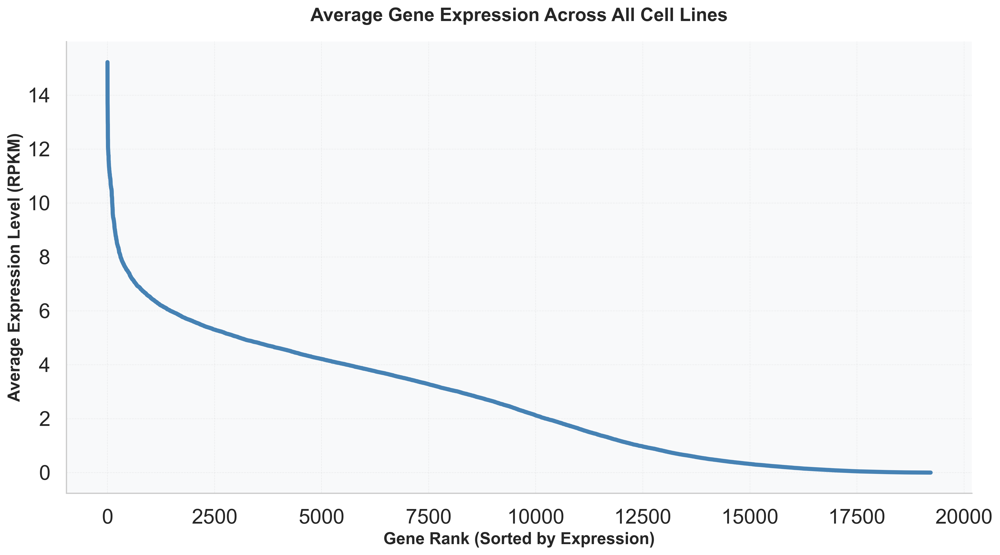

In [18]:

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

sns.set_theme(style="whitegrid")
# # sort by mean descending so the biggest are at top
mean_df_sorted = mean_df.sort_values("mean_expression", ascending=False)

# # use seaborn to plot a horizontal line plot of all the average gene expressions, but do not plot legends or labels for each gene
# plt.figure(figsize=(20, 10))
# sns.lineplot(x="gene", y="mean_expression", data=mean_df_sorted, palette="viridis", hue="mean_expression")
# # remove y axis labels
# plt.yticks([])
# # add labels and title
# plt.xlabel("Average Expression")
# plt.ylabel("Gene")
# plt.title("Average Gene Expression Across All Cell Lines")
# plt.tight_layout()
# plt.show()



# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Create the figure with journal-quality dimensions
fig, ax = plt.subplots(figsize=(14, 8))

# Plot the data
ax.plot(mean_df_sorted["mean_expression"].values, color="steelblue", linewidth=4)

# Customize the plot
ax.set_xlabel("Gene Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax.set_ylabel("Average Expression Level (RPKM)", fontsize=16, fontweight="bold")
ax.set_title(
    "Average Gene Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax.tick_params(axis="both", which="major", labelsize=20)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

# Add a subtle background
ax.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()

In [19]:
# randomly selected 10 columns from ccle
import numpy as np
# generate 10 random integers between 0 and len(ccle.columns)
random_cols = np.random.randint(0, len(ccle.columns), 10)

In [20]:
CDK4_example = ccle.loc[:, 'CDK4']

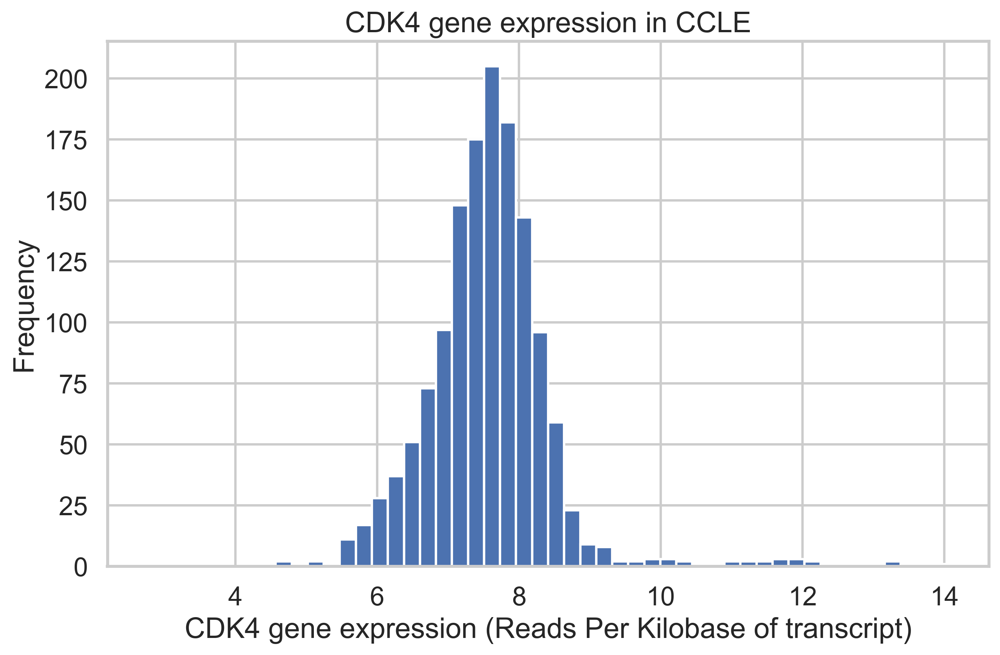

In [21]:
# plot CDK4 gene expression as a histogram

import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(10, 6))
plt.hist(CDK4_example, bins=50)
plt.xlabel('CDK4 gene expression (Reads Per Kilobase of transcript)')
plt.ylabel('Frequency')
plt.title('CDK4 gene expression in CCLE')
plt.show()


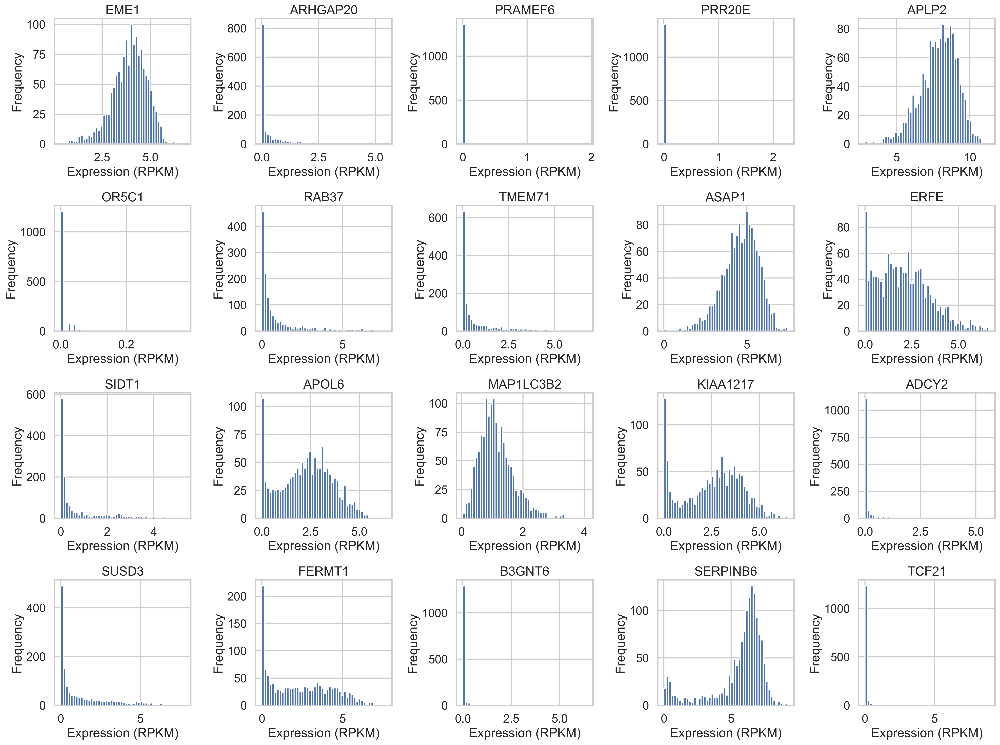

In [22]:
import numpy as np
# generate 10 random integers between 0 and len(ccle.columns)
random_cols = np.random.randint(0, len(ccle.columns), 20)

# plot 20 random genes as histograms, 4 rows, 5 columns

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    ax.hist(ccle.iloc[:, random_cols[i]], bins=50)
    ax.set_title(ccle.columns[random_cols[i]])
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Frequency')
plt.tight_layout()
plt.show()



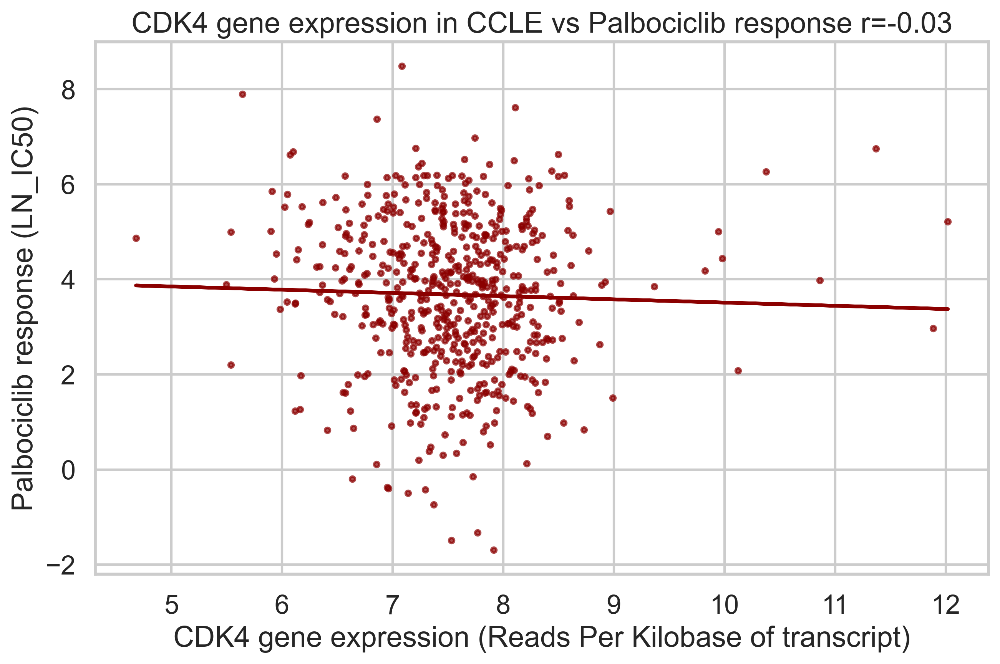

In [23]:
# correlate cdk4 expression with drug response

import DataFunctions as utils 

# import external libraries
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np


# create a joint dataframe of cdk4 expression and drug response for palbociclib
palbociclib_df = utils.create_joint_dataset_from_ccle_gdsc2('Palbociclib', gdsc2, ccle, ccle_sample_info)

# plot correlation between cdk4 expression and palbociclib response

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(10, 6))
plt.scatter(palbociclib_df['CDK4'], palbociclib_df['LN_IC50'], color='darkred', alpha=0.7, s=10)
# create line of best fit
m, b = np.polyfit(palbociclib_df['CDK4'], palbociclib_df['LN_IC50'], 1)
plt.plot(palbociclib_df['CDK4'], m*palbociclib_df['CDK4'] + b, color='darkred')
# show correlation coefficient in the title
corr = str(round(np.corrcoef(palbociclib_df['CDK4'], palbociclib_df['LN_IC50'])[0, 1], 2))
plt.xlabel('CDK4 gene expression (Reads Per Kilobase of transcript)')
plt.ylabel('Palbociclib response (LN_IC50)')
plt.title(f'CDK4 gene expression in CCLE vs Palbociclib response r={corr}')
plt.show()

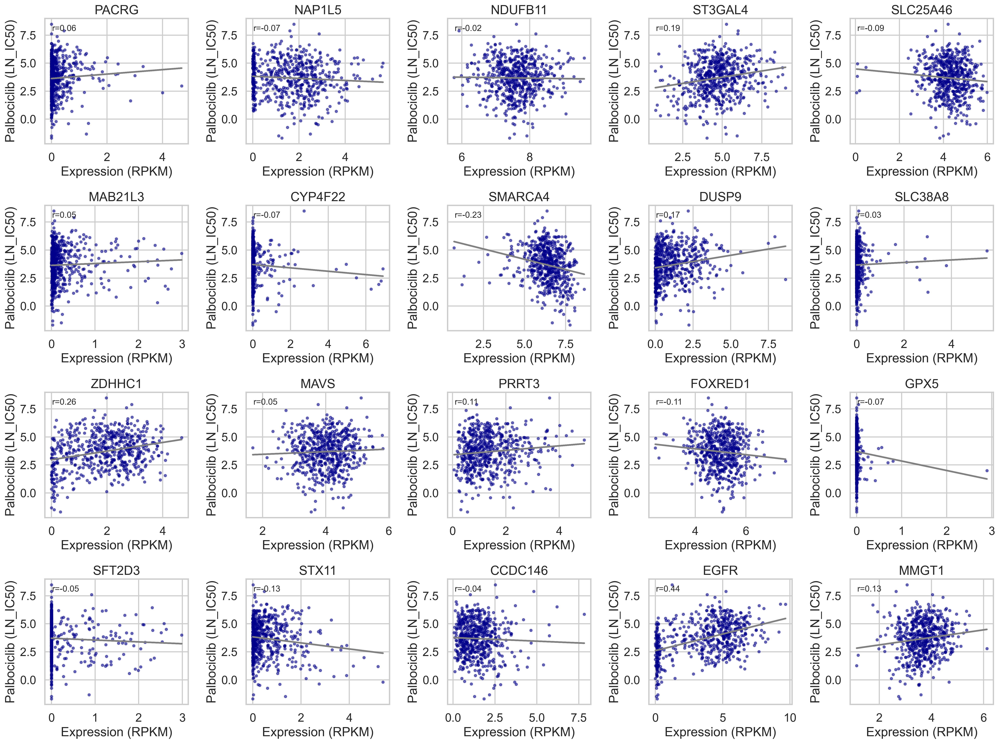

In [24]:
# for 20 random genes, plot correlation between gene expression and drug response

# generate 20 random integers between 0 and len(ccle.columns)
random_cols = np.random.randint(0, len(ccle.columns), 20)

# plot 20 random genes as histograms, 4 rows, 5 columns

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    # create a joint dataframe of gene expression and drug response for palbociclib
    gene = ccle.columns[random_cols[i]]
    # plot correlation between gene expression and palbociclib response
    ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkblue', alpha=0.5, s=10)
    # create line of best fit
    m, b = np.polyfit(palbociclib_df[gene], palbociclib_df['LN_IC50'], 1)
    ax.plot(palbociclib_df[gene], m*palbociclib_df[gene] + b, color='grey')
    # get correlation coefficient 
    corr = str(round(np.corrcoef(palbociclib_df[gene], palbociclib_df['LN_IC50'])[0, 1], 2))
    # insert correlation coefficient into text
    ax.text(0.05, 0.95, f'r={corr}', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    ax.set_title(f'{gene}')
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Palbociclib (LN_IC50)')
plt.tight_layout()
plt.show()

In [25]:
feature_data, label_data = utils.create_feature_and_label(palbociclib_df)

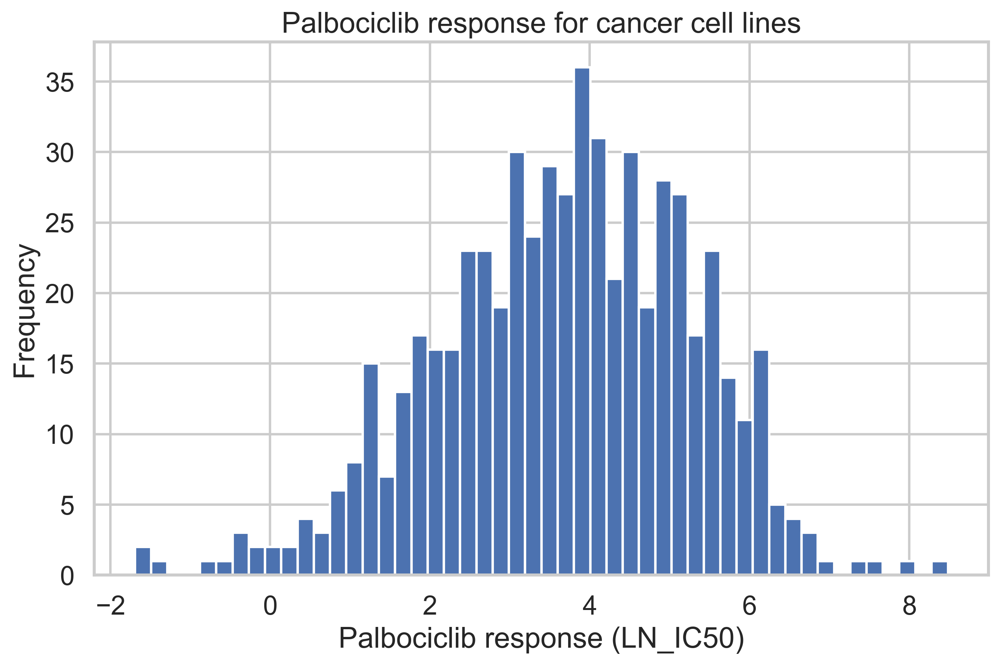

In [26]:
# histogram of label data

sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(10, 6))
plt.hist(label_data, bins=50)
plt.xlabel('Palbociclib response (LN_IC50)')
plt.ylabel('Frequency')
plt.title('Palbociclib response for cancer cell lines')
plt.show()

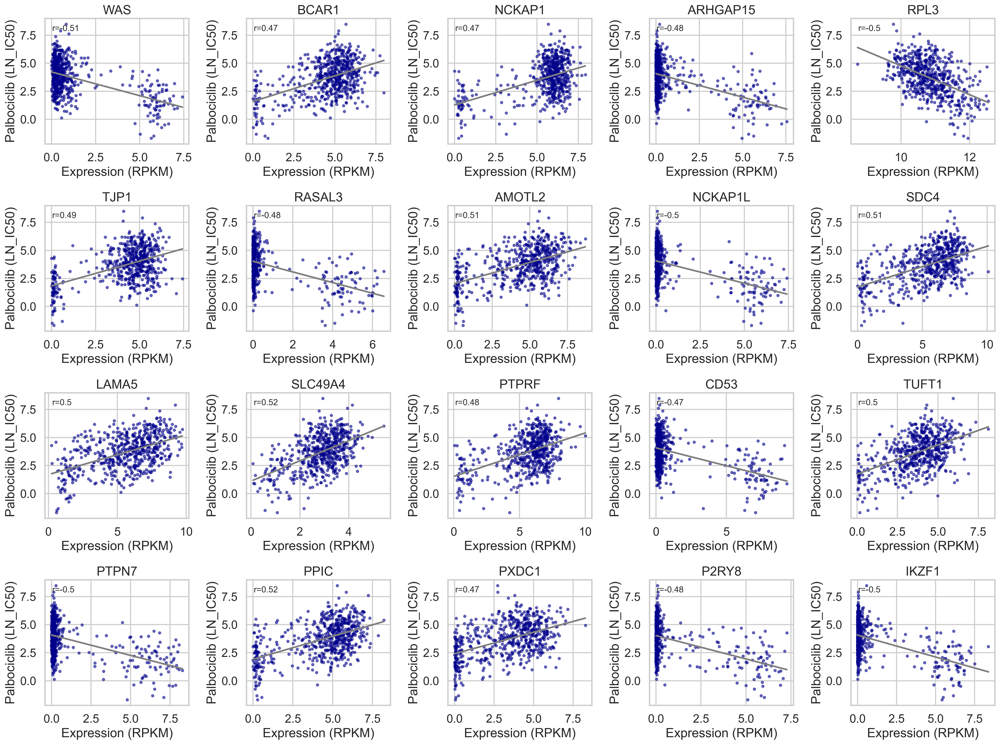

In [27]:
# using f-regression, select the top 20 features

from sklearn.feature_selection import SelectKBest, f_regression

# select the top 20 features
selector = SelectKBest(f_regression, k=20)
selector.fit(feature_data, label_data)

# get the names of the top 20 features return index = true
top_20_features_original = feature_data.columns[selector.get_support(indices=True)]

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    # create a joint dataframe of gene expression and drug response for palbociclib
    # print(top_20_features[i])
    gene = top_20_features_original[i]
    # plot correlation between gene expression and palbociclib response
    ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkblue', alpha=0.5, s=10)
    # create line of best fit
    m, b = np.polyfit(palbociclib_df[gene], palbociclib_df['LN_IC50'], 1)
    ax.plot(palbociclib_df[gene], m*palbociclib_df[gene] + b, color='grey')
    # get correlation coefficient 
    corr = str(round(np.corrcoef(palbociclib_df[gene], palbociclib_df['LN_IC50'])[0, 1], 2))
    # insert correlation coefficient into text
    ax.text(0.05, 0.95, f'r={corr}', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    ax.set_title(f'{gene}')
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Palbociclib (LN_IC50)')
plt.tight_layout()
plt.show()


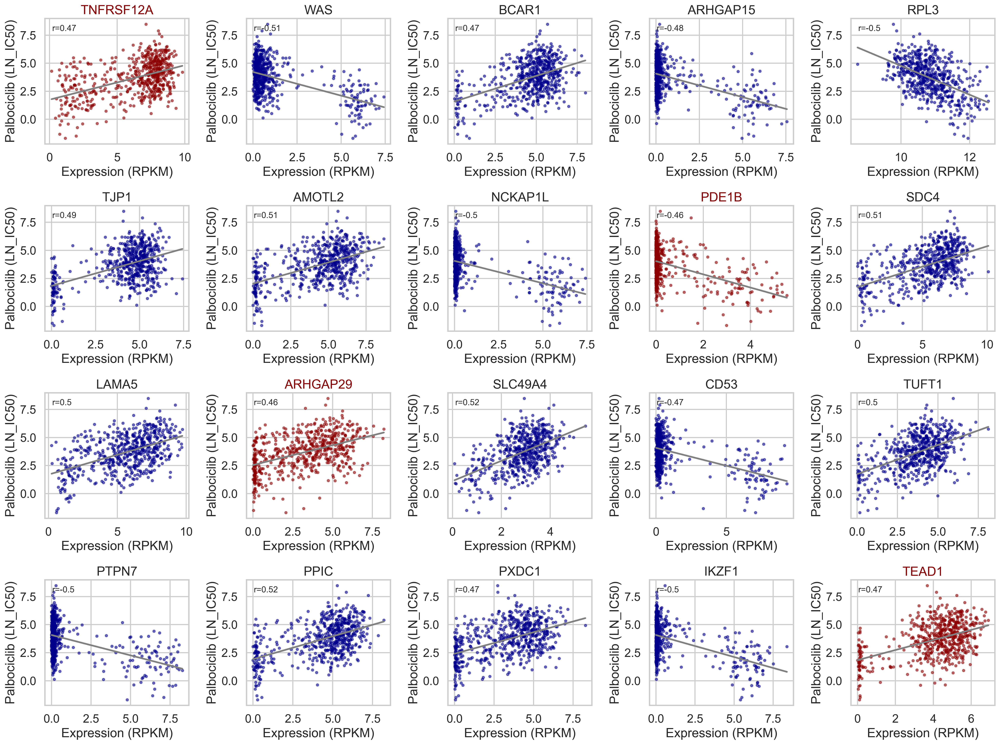

In [28]:
# using train_test_split, split the data into training and testing sets

from sklearn.model_selection import train_test_split

# split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(feature_data, label_data, test_size=0.2, random_state=2)

# select the top 20 features in the training set
selector = SelectKBest(f_regression, k=20)
selector.fit(X_train, y_train)

# get the names of the top 20 features return index = true
top_20_features = feature_data.columns[selector.get_support(indices=True)]

fig, axes = plt.subplots(4, 5, figsize=(20, 15))
for i, ax in enumerate(axes.flatten()):
    # create a joint dataframe of gene expression and drug response for palbociclib
    # print(top_20_features[i])
    gene = top_20_features[i]
    # plot correlation between gene expression and palbociclib response
    # make plot dark red if gene is not in original top 20 features
    if gene not in top_20_features_original:
        ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkred', alpha=0.5, s=10)
    else:
        ax.scatter(palbociclib_df[gene], palbociclib_df['LN_IC50'], color='darkblue', alpha=0.5, s=10)
    # create line of best fit
    m, b = np.polyfit(palbociclib_df[gene], palbociclib_df['LN_IC50'], 1)
    ax.plot(palbociclib_df[gene], m*palbociclib_df[gene] + b, color='grey')
    # get correlation coefficient 
    corr = str(round(np.corrcoef(palbociclib_df[gene], palbociclib_df['LN_IC50'])[0, 1], 2))
    # insert correlation coefficient into text
    ax.text(0.05, 0.95, f'r={corr}', transform=ax.transAxes, fontsize=12, verticalalignment='top')
    # make title red if gene is not in original top 20 features
    if gene not in top_20_features_original:
        ax.set_title(f'{gene}', color='darkred')
    else:
        ax.set_title(f'{gene}')
    ax.set_xlabel('Expression (RPKM)')
    ax.set_ylabel('Palbociclib (LN_IC50)')
plt.tight_layout()
plt.show()


# Goncalves Proteomics Dataset

### Loading

In [30]:
import pandas as pd
import pickle

# import GDSC2 drug response data using pickle

with open(f'{path_loader.get_data_path()}data/drug-response/GDSC2/cache_gdsc2.pkl', 'rb') as f:
    gdsc2 = pickle.load(f)
    gdsc2_info = pickle.load(f)

# import proteomic expression 
with open(f'{path_loader.get_data_path()}data/proteomic-expression/goncalves-2022-cell/goncalve_proteome_processed.pkl', 'rb') as f:
    joined_full_protein_matrix = pickle.load(f)
    joined_sin_peptile_exclusion_matrix = pickle.load(f)

### Missing values percentage

In [31]:
joined_sin_peptile_exclusion_matrix.shape

(949, 6692)

In [32]:
# count missing values in the proteomic matrix (joined_sin_peptile_exclusion_matrix)

total_missing = joined_sin_peptile_exclusion_matrix.isna().sum().sum()
total_cells = joined_sin_peptile_exclusion_matrix.size
pct_missing = total_missing / total_cells * 100

missing_per_col = joined_sin_peptile_exclusion_matrix.isna().sum()
missing_per_row = joined_sin_peptile_exclusion_matrix.isna().sum(axis=1)

print(f"Total missing: {total_missing} / {total_cells} ({pct_missing:.2f}%)\n")

print("Top 10 columns by missing count:")
print(missing_per_col.sort_values(ascending=False).head(10), "\n")

print("Top 10 rows by missing count:")
print(missing_per_row.sort_values(ascending=False).head(10), "\n")

print(f"Completely missing columns: {(missing_per_col == joined_sin_peptile_exclusion_matrix.shape[0]).sum()}")
print(f"Completely missing rows: {(missing_per_row == joined_sin_peptile_exclusion_matrix.shape[1]).sum()}")

# summary comparison: missing vs total cells
non_missing = total_cells - total_missing
print(f"Total cells: {total_cells:,}")
print(f"Missing cells: {total_missing:,} ({pct_missing:.2f}%)")
print(f"Non-missing cells: {non_missing:,} ({100 - pct_missing:.2f}%)")

Total missing: 3042799 / 6350708 (47.91%)

Top 10 columns by missing count:
P07202;PERT_HUMAN     948
P01266;THYG_HUMAN     948
O75339;CILP1_HUMAN    948
Q9BQN1;FA83C_HUMAN    948
Q8IYF3;TEX11_HUMAN    948
Q969I3;GLYL1_HUMAN    948
Q8WWA0;ITLN1_HUMAN    948
P00439;PH4H_HUMAN     948
P35713;SOX18_HUMAN    948
Q86W26;NAL10_HUMAN    948
dtype: int64 

Top 10 rows by missing count:
model_id
SIDM00437    5149
SIDM00676    4488
SIDM00042    4434
SIDM00485    4405
SIDM00807    4331
SIDM00172    4328
SIDM00829    4324
SIDM00450    4319
SIDM01051    4288
SIDM01002    4233
dtype: int64 

Completely missing columns: 0
Completely missing rows: 0
Total cells: 6,350,708
Missing cells: 3,042,799 (47.91%)
Non-missing cells: 3,307,909 (52.09%)


### Get Protein means

In [33]:
# get mean proteomic expression for each protein
protein_means = joined_sin_peptile_exclusion_matrix.mean()

protein_mean_df = protein_means.reset_index()
protein_mean_df.columns = ["protein", "mean_expression"]
protein_mean_df.head()


,protein,mean_expression
0,P37108;SRP14_HUMAN,6.466039
1,Q96JP5;ZFP91_HUMAN,3.607759
2,Q9Y4H2;IRS2_HUMAN,2.647074
3,P36578;RL4_HUMAN,7.315308
4,Q6SPF0;SAMD1_HUMAN,3.360244


In [34]:
# get the mean of the mean expressions
mean_df = protein_mean_df
mean_of_means = mean_df['mean_expression'].mean()
print(f'Mean of mean expressions: {mean_of_means}')

# how many genes have mean expression greater than the mean of means
num_genes_above_mean = (mean_df['mean_expression'] > mean_of_means
).sum()
print(f'Number of genes with mean expression above the mean of means: {num_genes_above_mean}')

# below mean of means
num_genes_below_mean = (mean_df['mean_expression'] <= mean_of_means
).sum()
print(f'Number of genes with mean expression below or equal to the mean of means: {num_genes_below_mean}')

# max and min mean expression
max_mean_expression = mean_df['mean_expression'].max()
min_mean_expression = mean_df['mean_expression'].min()

print(f'Max mean expression: {max_mean_expression}')
print(f'Min mean expression: {min_mean_expression}')

# how many zero mean expressions
num_zero_mean_expressions = (mean_df['mean_expression'] == 0).sum()
print(f'Number of genes with zero mean expression: {num_zero_mean_expressions}')

Mean of mean expressions: 3.694050812603664
Number of genes with mean expression above the mean of means: 2776
Number of genes with mean expression below or equal to the mean of means: 3916
Max mean expression: 13.45003717597471
Min mean expression: 0.14484136363636366
Number of genes with zero mean expression: 0


In [35]:
mean_df

,protein,mean_expression
0,P37108;SRP14_HUMAN,6.466039
1,Q96JP5;ZFP91_HUMAN,3.607759
2,Q9Y4H2;IRS2_HUMAN,2.647074
3,P36578;RL4_HUMAN,7.315308
4,Q6SPF0;SAMD1_HUMAN,3.360244
...,...,...
6687,Q7Z3B1;NEGR1_HUMAN,3.484849
6688,O60669;MOT2_HUMAN,1.742722
6689,Q13571;LAPM5_HUMAN,3.381009
6690,Q96JM2;ZN462_HUMAN,3.110338


In [36]:
protein_mean_df

,protein,mean_expression
0,P37108;SRP14_HUMAN,6.466039
1,Q96JP5;ZFP91_HUMAN,3.607759
2,Q9Y4H2;IRS2_HUMAN,2.647074
3,P36578;RL4_HUMAN,7.315308
4,Q6SPF0;SAMD1_HUMAN,3.360244
...,...,...
6687,Q7Z3B1;NEGR1_HUMAN,3.484849
6688,O60669;MOT2_HUMAN,1.742722
6689,Q13571;LAPM5_HUMAN,3.381009
6690,Q96JM2;ZN462_HUMAN,3.110338


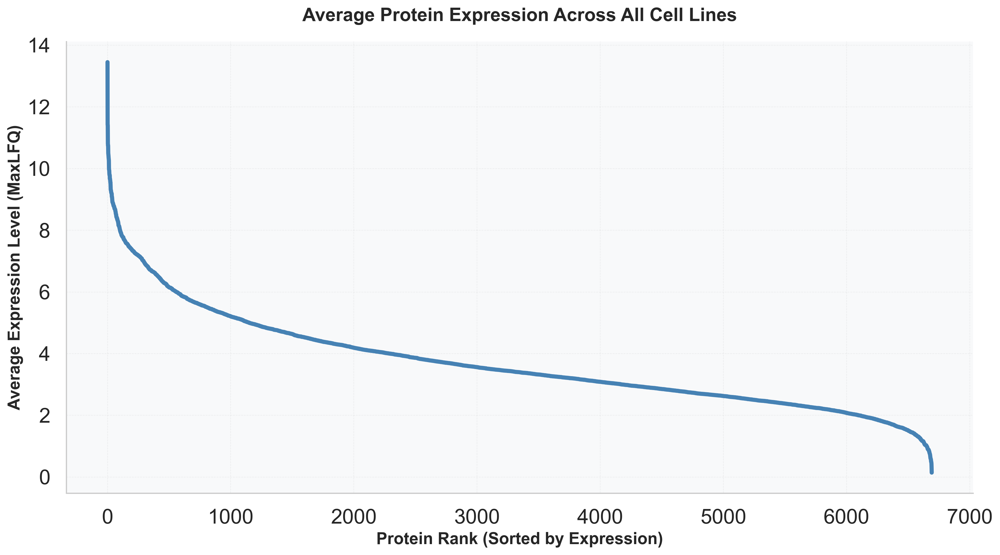

In [37]:

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl

sns.set_theme(style="whitegrid")
# # sort by mean descending so the biggest are at top
mean_df_sorted = protein_mean_df.sort_values("mean_expression", ascending=False)

# # use seaborn to plot a horizontal line plot of all the average gene expressions, but do not plot legends or labels for each gene
# plt.figure(figsize=(20, 10))
# sns.lineplot(x="gene", y="mean_expression", data=mean_df_sorted, palette="viridis", hue="mean_expression")
# # remove y axis labels
# plt.yticks([])
# # add labels and title
# plt.xlabel("Average Expression")
# plt.ylabel("Gene")
# plt.title("Average Gene Expression Across All Cell Lines")
# plt.tight_layout()
# plt.show()



# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Create the figure with journal-quality dimensions
fig, ax = plt.subplots(figsize=(14, 8))

# Plot the data
ax.plot(mean_df_sorted["mean_expression"].values, color="steelblue", linewidth=4)

# Customize the plot
ax.set_xlabel("Protein Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax.set_ylabel("Average Expression Level (MaxLFQ)", fontsize=16, fontweight="bold")
ax.set_title(
    "Average Protein Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax.tick_params(axis="both", which="major", labelsize=20)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

# Add a subtle background
ax.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()

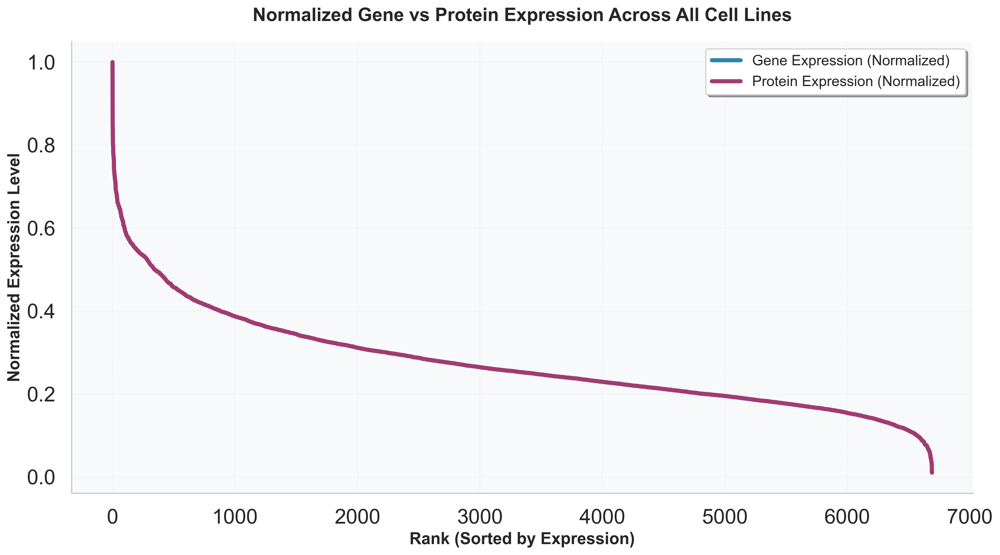

In [38]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np

sns.set_theme(style="whitegrid")

# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Sort both dataframes by mean descending
gene_mean_sorted = mean_df.sort_values("mean_expression", ascending=False)
protein_mean_sorted = protein_mean_df.sort_values("mean_expression", ascending=False)

# Normalize to respective max values
gene_normalized = (
    gene_mean_sorted["mean_expression"] / gene_mean_sorted["mean_expression"].max()
)
protein_normalized = (
    protein_mean_sorted["mean_expression"]
    / protein_mean_sorted["mean_expression"].max()
)

# Create the figure with journal-quality dimensions
fig, ax = plt.subplots(figsize=(14, 8))

# Plot both normalized datasets
ax.plot(
    gene_normalized.values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression (Normalized)",
)
ax.plot(
    protein_normalized.values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression (Normalized)",
)

# Customize the plot
ax.set_xlabel("Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax.set_ylabel("Normalized Expression Level", fontsize=16, fontweight="bold")
ax.set_title(
    "Normalized Gene vs Protein Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax.tick_params(axis="both", which="major", labelsize=20)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

# Add legend
ax.legend(fontsize=14, frameon=True, fancybox=True, shadow=True)

# Add a subtle background
ax.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


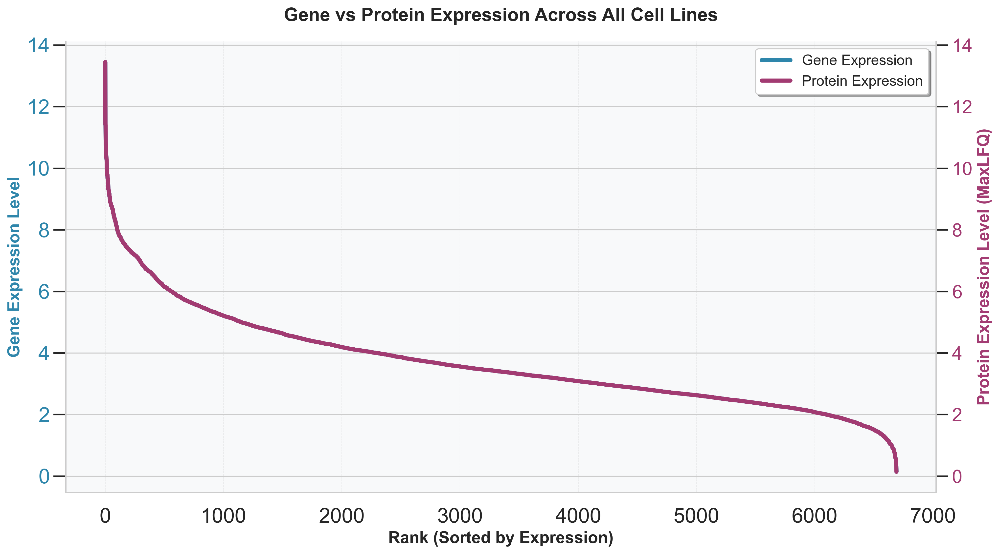

In [39]:
# Create the figure with journal-quality dimensions
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot gene expression on primary axis
ax1.plot(
    gene_mean_sorted["mean_expression"].values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression",
)
ax1.set_xlabel("Rank (Sorted by Expression)", fontsize=16, fontweight="bold")
ax1.set_ylabel("Gene Expression Level", fontsize=16, fontweight="bold", color="#2E86AB")
ax1.tick_params(axis="y", labelcolor="#2E86AB")

# Create secondary axis for protein expression
ax2 = ax1.twinx()
ax2.plot(
    protein_mean_sorted["mean_expression"].values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression",
)
ax2.set_ylabel(
    "Protein Expression Level (MaxLFQ)", fontsize=16, fontweight="bold", color="#A23B72"
)
ax2.tick_params(axis="y", labelcolor="#A23B72")

# Customize the plot
ax1.set_title(
    "Gene vs Protein Expression Across All Cell Lines",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

# Improve tick labels
ax1.tick_params(axis="both", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Combine legends from both axes
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=14,
    frameon=True,
    fancybox=True,
    shadow=True,
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


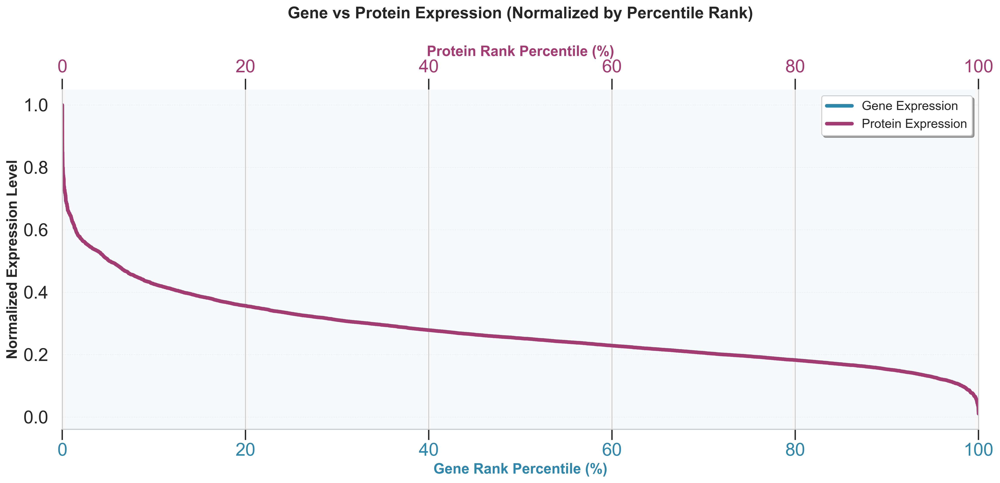

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

sns.set_theme(style="whitegrid")

# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

# Sort both dataframes by mean descending
gene_mean_sorted = mean_df.sort_values("mean_expression", ascending=False)
protein_mean_sorted = protein_mean_df.sort_values("mean_expression", ascending=False)

# Normalize to respective max values
gene_normalized = (
    gene_mean_sorted["mean_expression"] / gene_mean_sorted["mean_expression"].max()
)
protein_normalized = (
    protein_mean_sorted["mean_expression"]
    / protein_mean_sorted["mean_expression"].max()
)

# Create percentage indices for both datasets
gene_percentage = np.linspace(0, 100, len(gene_normalized))
protein_percentage = np.linspace(0, 100, len(protein_normalized))

# Create the figure with dual x-axes
fig, ax1 = plt.subplots(figsize=(16, 8))

# Plot gene expression on primary x-axis
ax1.plot(
    gene_percentage,
    gene_normalized.values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression",
)
ax1.set_xlabel(
    "Gene Rank Percentile (%)", fontsize=16, fontweight="bold", color="#2E86AB"
)
ax1.set_ylabel("Normalized Expression Level", fontsize=16, fontweight="bold")
ax1.tick_params(axis="x", labelcolor="#2E86AB")

# Create secondary x-axis for protein expression
ax2 = ax1.twiny()  # Create a second x-axis at the top
ax2.plot(
    protein_percentage,
    protein_normalized.values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression",
)
ax2.set_xlabel(
    "Protein Rank Percentile (%)", fontsize=16, fontweight="bold", color="#A23B72"
)
ax2.tick_params(axis="x", labelcolor="#A23B72")

# Set the same x-limits for both axes
ax1.set_xlim(0, 100)
ax2.set_xlim(0, 100)

# Customize the plot
ax1.set_title(
    "Gene vs Protein Expression (Normalized by Percentile Rank)",
    fontsize=18,
    fontweight="bold",
    pad=30,
)

# Improve tick labels
ax1.tick_params(axis="both", which="major", labelsize=20)
ax2.tick_params(axis="x", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=14,
    frameon=True,
    fancybox=True,
    shadow=True,
    loc="upper right",
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


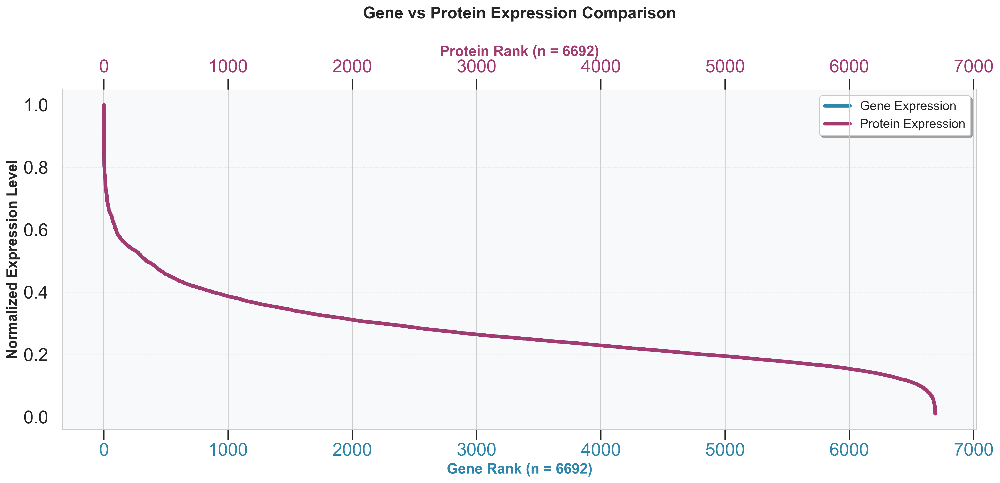

In [41]:
# Create the figure with dual x-axes showing actual counts
fig, ax1 = plt.subplots(figsize=(16, 8))

# Plot gene expression on primary x-axis (actual gene indices)
ax1.plot(
    range(len(gene_normalized)),
    gene_normalized.values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Expression",
)
ax1.set_xlabel(
    "Gene Rank (n = {})".format(len(gene_normalized)),
    fontsize=16,
    fontweight="bold",
    color="#2E86AB",
)
ax1.set_ylabel("Normalized Expression Level", fontsize=16, fontweight="bold")
ax1.tick_params(axis="x", labelcolor="#2E86AB")

# Create secondary x-axis for protein expression (actual protein indices)
ax2 = ax1.twiny()
ax2.plot(
    range(len(protein_normalized)),
    protein_normalized.values,
    color="#A23B72",
    linewidth=4,
    label="Protein Expression",
)
ax2.set_xlabel(
    "Protein Rank (n = {})".format(len(protein_normalized)),
    fontsize=16,
    fontweight="bold",
    color="#A23B72",
)
ax2.tick_params(axis="x", labelcolor="#A23B72")

# Customize the plot
ax1.set_title(
    "Gene vs Protein Expression Comparison",
    fontsize=18,
    fontweight="bold",
    pad=30,
)

# Improve tick labels and grid
ax1.tick_params(axis="both", which="major", labelsize=20)
ax2.tick_params(axis="x", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=14,
    frameon=True,
    fancybox=True,
    shadow=True,
    loc="upper right",
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


### Generating Heat Maps


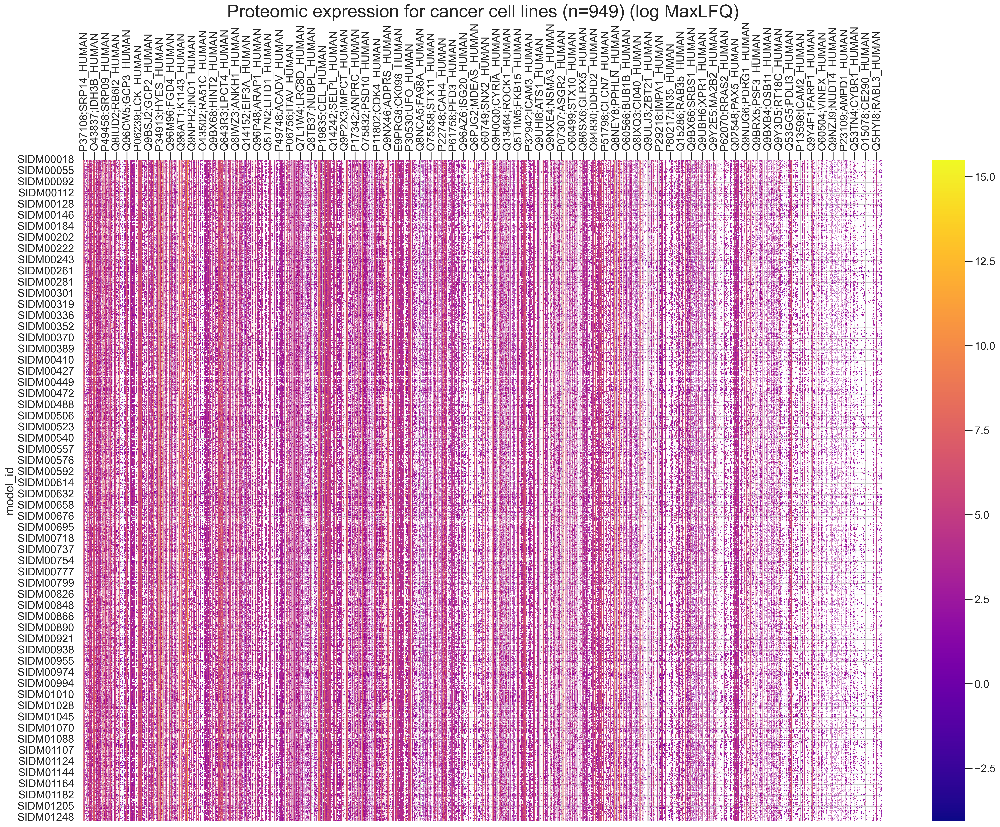

In [42]:
# visualise joined_sin_peptile_exclusion_matrix as a heatmap

import seaborn as sns
import matplotlib.pyplot as plt


fig, ax = plt.subplots(figsize=(30, 20))

sns.heatmap(joined_sin_peptile_exclusion_matrix, cmap='plasma')

# xlabel on top of heatmap
ax.xaxis.tick_top()

# rotate xtick labels
plt.xticks(rotation=90)

# set title 
plt.title('Proteomic expression for cancer cell lines (n=949) (log MaxLFQ)', fontsize=30)

plt.show()
# legend is labelled as 'proteomic expression (log MaxLFQ)'

In [44]:
# load in data

import pandas as pd
import pickle

# import GDSC2 drug response data using pickle

with open(f'{path_loader.get_data_path()}data/drug-response/GDSC2/cache_gdsc2.pkl', 'rb') as f:
    gdsc2 = pickle.load(f)
    gdsc2_info = pickle.load(f)

# import CCLE gene expression data using pickle

with open(f'{path_loader.get_data_path()}data/gene-expression/CCLE_Public_22Q2/ccle_expression.pkl', 'rb') as f:
    gene_entrez = pickle.load(f)
    ccle = pickle.load(f)

# import CCLE sample info data using pickle

with open(f'{path_loader.get_data_path()}data/gene-expression/CCLE_Public_22Q2/ccle_sample_info.pkl', 'rb') as f:
    ccle_sample_info = pickle.load(f)


In [45]:
ccle.shape

(1406, 19222)

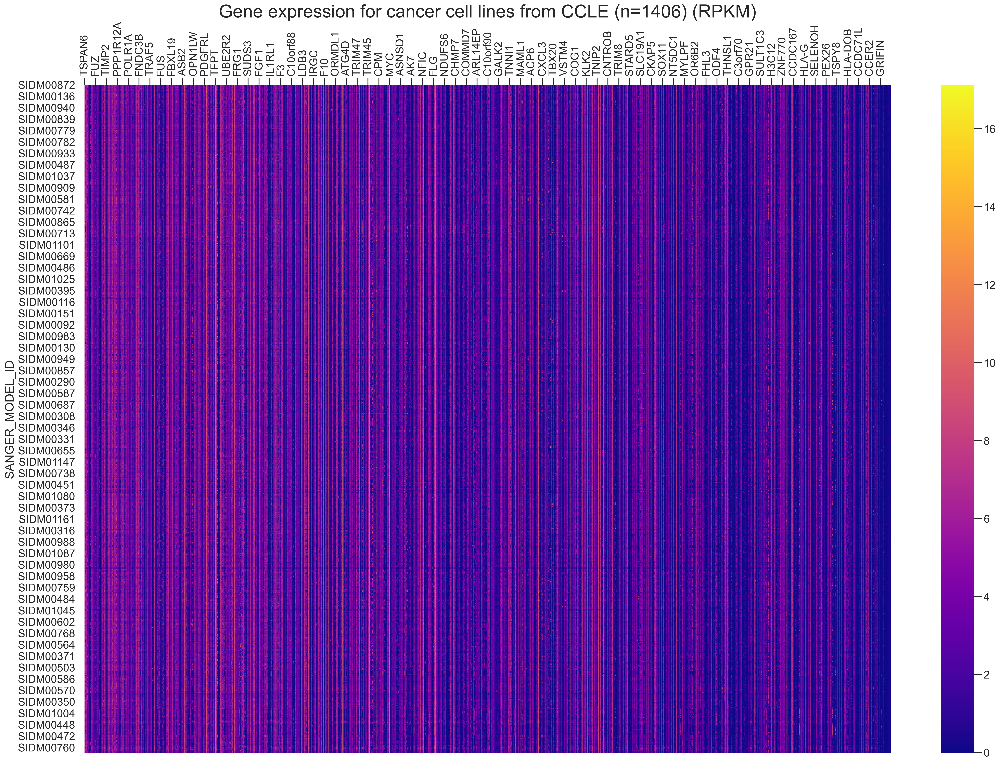

In [46]:
import DataFunctions as utils 

df = utils.create_joint_dataset_from_ccle_gdsc2('Palbociclib', gdsc2, ccle, ccle_sample_info)

feature_data, label_data = utils.create_feature_and_label(df)

# visualise ccle as a heatmap

fig, ax = plt.subplots(figsize=(30, 20))

sns.heatmap(feature_data, cmap='plasma')

# xlabel on top of heatmap
ax.xaxis.tick_top()

# rotate xtick labels
plt.xticks(rotation=90)

# set title
plt.title('Gene expression for cancer cell lines from CCLE (n=1406) (RPKM)', fontsize=30)

plt.show()



## Palbociclib dataset

In [47]:
# correlate cdk4 expression with drug response
import DataFunctions as utils 
# import external libraries
import numpy as np

# create a joint dataframe of cdk4 expression and drug response for palbociclib
# load in original ccle data
loading_code = "goncalves-gdsc-2-Palbociclib-LN_IC50-sin"
# generic-gdsc-{number}-{drug_name}-{target_label}-{dataset_name}-{replace_index}-{row_index}
proteomic_feature_data, proteomic_label_data = data_link.get_data_using_code(loading_code)

print(f'Proteomic feature data shape: {proteomic_feature_data.shape}', f'Proteomic label data shape: {proteomic_label_data.shape}')

loading_code = "ccle-gdsc-2-Palbociclib-LN_IC50"
ccle_feature_data, ccle_label_data = data_link.get_data_using_code(loading_code)

print(f'CCLE feature data shape: {ccle_feature_data.shape}', f'CCLE label data shape: {ccle_label_data.shape}')

Proteomic feature data shape: (737, 6692) Proteomic label data shape: (737,)
CCLE feature data shape: (584, 19221) CCLE label data shape: (584,)


C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3865580933.py:139: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


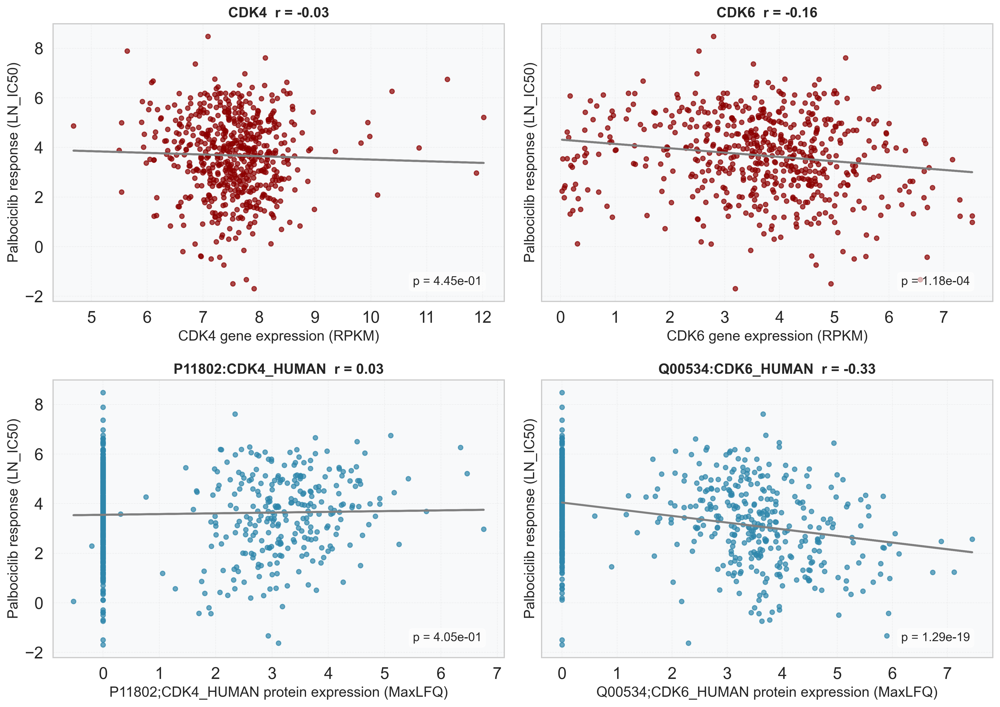

In [48]:
import numpy as np
from scipy.stats import pearsonr
import matplotlib.pyplot as plt

gene_names = ["CDK4", "CDK6"]
protein_names = ["P11802:CDK4_HUMAN", "Q00534:CDK6_HUMAN"]

# prepare features and axes
features = [
    ("gene", gene_names[0]),
    ("gene", gene_names[1]),
    ("protein", protein_names[0]),
    ("protein", protein_names[1]),
]

# Journal-quality figure setup: large fonts, high DPI, clean background, shared y-axis for comparability
plt.rcParams.update(
    {
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "font.size": 18,
        "font.family": "sans-serif",
        "axes.labelsize": 20,
        "axes.titlesize": 20,
        "xtick.labelsize": 16,
        "ytick.labelsize": 16,
        "axes.linewidth": 1.2,
        "lines.linewidth": 2.5,
        "xtick.major.size": 8,
        "ytick.major.size": 8,
    }
)

fig, axes = plt.subplots(
    2,
    2,
    figsize=(14, 10),
    dpi=300,
    sharey=True,
    constrained_layout=True,
)

# apply consistent styling to each axis before plotting
for ax in axes.flatten():
    ax.set_facecolor("#f8f9fa")
    ax.grid(True, alpha=0.25, linestyle="--", linewidth=0.5)
    ax.tick_params(axis="both", which="major", labelsize=16, width=1.2, length=6)
axes = axes.flatten()

def find_protein_column(prot_name, df):
    # try common variants: replace ':'->';', exact match, or match by gene symbol
    cand = prot_name.replace(":", ";")
    if cand in df.columns:
        return cand
    if prot_name in df.columns:
        return prot_name
    # try gene symbol (e.g. "P11802:CDK4_HUMAN" -> "CDK4")
    if ":" in prot_name:
        gene_sym = prot_name.split(":")[1].split("_")[0]
    else:
        gene_sym = prot_name.split("_")[0]
    for col in df.columns:
        if gene_sym.upper() in col.upper():
            return col
    return None

for ax, (ftype, name) in zip(axes, features):
    if ftype == "gene":
        if name not in ccle_feature_data.columns:
            ax.text(0.5, 0.5, f"{name} not found in CCLE", ha="center")
            ax.set_axis_off()
            continue
        x = ccle_feature_data[name]
        y = ccle_label_data
        xlabel = f"{name} gene expression (RPKM)"
        color = "darkred"
    else:  # protein
        col = find_protein_column(name, proteomic_feature_data)
        if col is None:
            ax.text(0.5, 0.5, f"{name} not found in proteomics", ha="center")
            ax.set_axis_off()
            continue
        x = proteomic_feature_data[col]
        y = proteomic_label_data
        xlabel = f"{col} protein expression (MaxLFQ)"
        color = "#2E86AB"

    # align indices and drop nans
    joint = pd.concat([x, y], axis=1, join="inner").dropna()
    if joint.shape[0] < 3:
        ax.text(0.5, 0.5, "insufficient data", ha="center")
        ax.set_axis_off()
        continue

    xs = joint.iloc[:, 0].values
    ys = joint.iloc[:, 1].values

    # scatter + fit
    ax.scatter(xs, ys, color=color, alpha=0.7, s=20)
    m, b = np.polyfit(xs, ys, 1)
    # draw regression line
    ax.plot(xs, m * xs + b, color="grey", linewidth=2)
    # compute Pearson p-value for annotation (non-fatal if it fails)
    try:
        _, p_line = pearsonr(xs, ys)
    except Exception:
        p_line = np.nan
    # annotate p-value on the plot (bottom-right corner)
    ann_text = f"p = {p_line:.2e}" if not np.isnan(p_line) else "p = n/a"
    ax.annotate(
        ann_text,
        xy=(0.95, 0.05),
        xycoords="axes fraction",
        ha="right",
        va="bottom",
        fontsize=12,
        bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.6),
    )
    try:
        corr, pval = pearsonr(xs, ys)
    except Exception:
        # fallback to numpy-based correlation if pearsonr fails (e.g. constant input)
        try:
            corr = np.corrcoef(xs, ys)[0, 1]
        except Exception:
            corr = np.nan
        pval = np.nan

    # ensure corr is a real number
    if np.isnan(corr):
        corr = 0.0
    # stats
    corr = np.corrcoef(xs, ys)[0, 1]
    ax.set_title(f"{name}  r = {corr:.2f}", fontsize=14, fontweight="bold")
    ax.set_xlabel(xlabel, fontsize=14)
    ax.set_ylabel("Palbociclib response (LN_IC50)", fontsize=14)
    ax.grid(alpha=0.25)

plt.tight_layout()
plt.show()

In [49]:
from scipy.stats import pearsonr, spearmanr
import pandas as pd
import numpy as np

# features to test (use protein identifiers first, fall back to gene symbols)
protein_names = ["P11802:CDK4_HUMAN", "Q00534:CDK6_HUMAN"]
gene_names = ["CDK4", "CDK6"]
results = []

def find_column(name, df):
    # try common variants: replace ':'->';', exact, or match by gene symbol
    cand = name.replace(":", ";")
    if cand in df.columns:
        return cand
    if name in df.columns:
        return name
    if ":" in name:
        gene_sym = name.split(":")[1].split("_")[0]
    else:
        gene_sym = name.split("_")[0]
    for col in df.columns:
        if gene_sym.upper() in col.upper():
            return col
    return None

# compute correlations for proteomic identifiers
for pname in protein_names:
    used = find_column(pname, proteomic_feature_data)
    entry = {
        "requested": pname,
        "used_column": used,
        "feature_type": "proteomics",
        "source": "proteomics",
        "n": 0,
        "pearson_r": np.nan,
        "pearson_p": np.nan,
        "pearson_r2": np.nan,
        "spearman_r": np.nan,
        "spearman_p": np.nan,
        "spearman_r2": np.nan,
        "abs_pearson": np.nan,
    }
    if used is None:
        results.append(entry)
        continue

    x = proteomic_feature_data[used]
    y = proteomic_label_data
    joint = pd.concat([x, y], axis=1, join="inner").dropna()
    entry["n"] = joint.shape[0]
    if joint.shape[0] >= 2:
        try:
            pr, pp = pearsonr(joint.iloc[:, 0].values, joint.iloc[:, 1].values)
        except Exception:
            pr, pp = np.nan, np.nan
        try:
            sr, sp = spearmanr(joint.iloc[:, 0].values, joint.iloc[:, 1].values)
        except Exception:
            sr, sp = np.nan, np.nan
        entry.update(
            {
                "pearson_r": pr,
                "pearson_p": pp,
                "pearson_r2": (pr ** 2) if not np.isnan(pr) else np.nan,
                "spearman_r": sr,
                "spearman_p": sp,
                "spearman_r2": (sr ** 2) if not np.isnan(sr) else np.nan,
                "abs_pearson": np.abs(pr) if not np.isnan(pr) else np.nan,
            }
        )
    results.append(entry)

# compute correlations for gene symbols (CCLE)
for gname in gene_names:
    used = find_column(gname, ccle_feature_data)
    entry = {
        "requested": gname,
        "used_column": used,
        "feature_type": "gene",
        "source": "ccle",
        "n": 0,
        "pearson_r": np.nan,
        "pearson_p": np.nan,
        "pearson_r2": np.nan,
        "spearman_r": np.nan,
        "spearman_p": np.nan,
        "spearman_r2": np.nan,
        "abs_pearson": np.nan,
    }
    if used is None:
        results.append(entry)
        continue

    x = ccle_feature_data[used]
    y = ccle_label_data
    joint = pd.concat([x, y], axis=1, join="inner").dropna()
    entry["n"] = joint.shape[0]
    if joint.shape[0] >= 2:
        try:
            pr, pp = pearsonr(joint.iloc[:, 0].values, joint.iloc[:, 1].values)
        except Exception:
            pr, pp = np.nan, np.nan
        try:
            sr, sp = spearmanr(joint.iloc[:, 0].values, joint.iloc[:, 1].values)
        except Exception:
            sr, sp = np.nan, np.nan
        entry.update(
            {
                "pearson_r": pr,
                "pearson_p": pp,
                "pearson_r2": (pr ** 2) if not np.isnan(pr) else np.nan,
                "spearman_r": sr,
                "spearman_p": sp,
                "spearman_r2": (sr ** 2) if not np.isnan(sr) else np.nan,
                "abs_pearson": np.abs(pr) if not np.isnan(pr) else np.nan,
            }
        )
    results.append(entry)

# create/update dataframe sorted by absolute Pearson
res_df = pd.DataFrame(results)
res_df = res_df.sort_values("abs_pearson", ascending=False).reset_index(drop=True)



In [50]:
res_df

,requested,used_column,feature_type,source,n,pearson_r,pearson_p,pearson_r2,spearman_r,spearman_p,spearman_r2,abs_pearson
0,Q00534:CDK6_HUMAN,Q00534;CDK6_HUMAN,proteomics,proteomics,737,-0.325197,1.294920e-19,0.105753,-0.322918,2.391372e-19,0.104276,0.325197
1,CDK6,CDK6,gene,ccle,584,-0.158634,1.182416e-04,0.025165,-0.167700,4.643950e-05,0.028123,0.158634
2,CDK4,CDK4,gene,ccle,584,-0.031645,4.452843e-01,0.001001,-0.062365,1.322352e-01,0.003889,0.031645
3,P11802:CDK4_HUMAN,P11802;CDK4_HUMAN,proteomics,proteomics,737,0.030702,4.052631e-01,0.000943,0.028474,4.402082e-01,0.000811,0.030702


In [51]:
import numpy as np
import pandas as pd
from scipy.stats import pearsonr
import seaborn as sns

# compute Pearson r for every gene in ccle_feature_data vs ccle_label_data
import matplotlib.pyplot as plt

results = []
for gene in ccle_feature_data.columns:
    x = ccle_feature_data[gene]
    joint = pd.concat([x, ccle_label_data], axis=1, join="inner").dropna()
    n = joint.shape[0]
    if n < 2:
        results.append((gene, np.nan, np.nan, n))
        continue
    xs = joint.iloc[:, 0].values
    ys = joint.iloc[:, 1].values
    try:
        r, p = pearsonr(xs, ys)
    except Exception:
        r, p = np.nan, np.nan
    results.append((gene, r, p, n))

corr_df = pd.DataFrame(results, columns=["gene", "pearson_r", "pearson_p", "n"])
corr_df["abs_pearson"] = corr_df["pearson_r"].abs()

# sort by absolute Pearson (largest effects first)
corr_sorted = corr_df.sort_values("abs_pearson", ascending=False).reset_index(drop=True)



C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3638698706.py:20: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3638698706.py:20: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3638698706.py:20: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3638698706.py:20: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3638698706.py:20: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\3638698706

In [52]:
# compute Pearson r for every protein in proteomic_feature_data vs proteomic_label_data
results_prot = []
for prot in proteomic_feature_data.columns:
    x = proteomic_feature_data[prot]
    joint = pd.concat([x, proteomic_label_data], axis=1, join="inner").dropna()
    n = joint.shape[0]
    if n < 2:
        results_prot.append((prot, np.nan, np.nan, n))
        continue
    xs = joint.iloc[:, 0].values
    ys = joint.iloc[:, 1].values
    try:
        r, p = pearsonr(xs, ys)
    except Exception:
        r, p = np.nan, np.nan
    results_prot.append((prot, r, p, n))

corr_df_prot = pd.DataFrame(
    results_prot, columns=["protein", "pearson_r", "pearson_p", "n"]
)
corr_df_prot["abs_pearson"] = corr_df_prot["pearson_r"].abs()
corr_sorted_prot = corr_df_prot.sort_values("abs_pearson", ascending=False).reset_index(
    drop=True
)




C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\1456797198.py:13: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\1456797198.py:13: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\1456797198.py:13: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\1456797198.py:13: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\1456797198.py:13: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  r, p = pearsonr(xs, ys)
C:\Users\l8105\AppData\Local\Temp\ipykernel_30960\1456797198

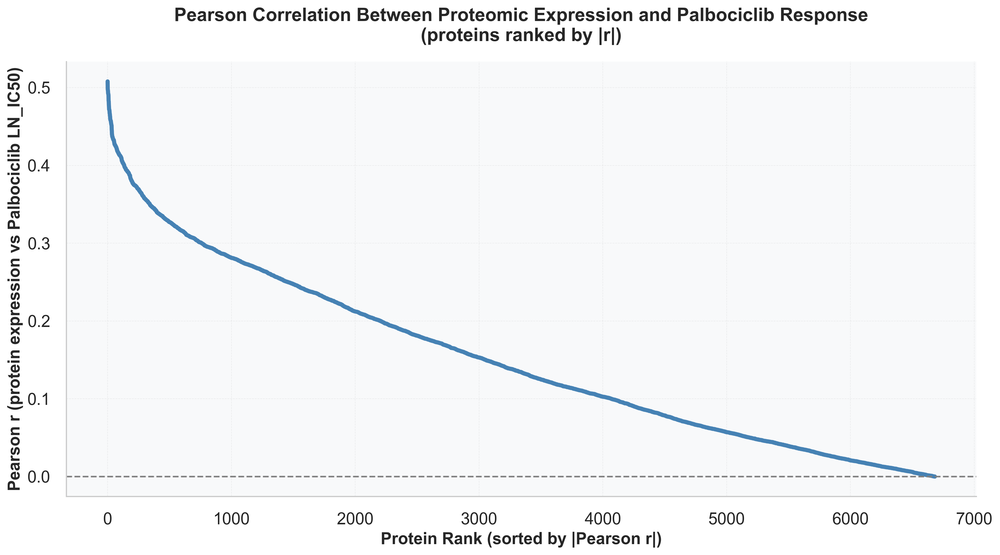

Top 10 proteins by |Pearson r|:


,protein,pearson_r,pearson_p,n
0,O95292;VAPB_HUMAN,0.507857,1.419308e-49,737
1,Q92556;ELMO1_HUMAN,-0.498027,1.875347e-47,737
2,Q13422;IKZF1_HUMAN,-0.496840,3.345906e-47,737
3,P15151;PVR_HUMAN,0.495616,6.064733e-47,737
4,Q92608;DOCK2_HUMAN,-0.492681,2.500558e-46,737
5,O60716;CTND1_HUMAN,0.491859,3.707961e-46,737
6,Q9UBI6;GBG12_HUMAN,0.491532,4.337182e-46,737
7,Q07157;ZO1_HUMAN,0.489920,9.357110e-46,737
8,O95302;FKBP9_HUMAN,0.482942,2.493070e-44,737
9,Q6JBY9;CPZIP_HUMAN,-0.482321,3.326552e-44,737


In [53]:
# Quick journal-quality plot (matching style used above)
sns.set_theme(style="whitegrid")
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

fig, ax = plt.subplots(figsize=(14, 8))
ax.plot(corr_sorted_prot["abs_pearson"].values, color="steelblue", linewidth=4)
ax.axhline(0, color="grey", linestyle="--", linewidth=1.5)
ax.set_xlabel("Protein Rank (sorted by |Pearson r|)", fontsize=16, fontweight="bold")
ax.set_ylabel(
    "Pearson r (protein expression vs Palbociclib LN_IC50)",
    fontsize=16,
    fontweight="bold",
)
ax.set_title(
    "Pearson Correlation Between Proteomic Expression and Palbociclib Response\n(proteins ranked by |r|)",
    fontsize=18,
    fontweight="bold",
    pad=20,
)
ax.tick_params(axis="both", which="major", labelsize=16)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.set_facecolor("#f8f9fa")
plt.tight_layout()
plt.show()

# show top 10 proteins by absolute Pearson
print("Top 10 proteins by |Pearson r|:")
corr_sorted_prot.loc[:9, ["protein", "pearson_r", "pearson_p", "n"]]


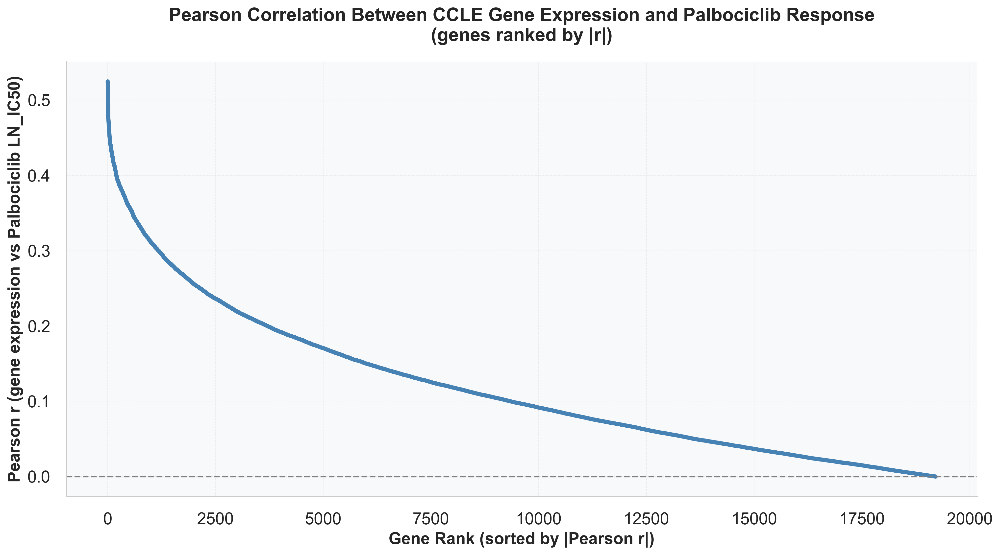

Top 10 genes by |Pearson r|:


,gene,pearson_r,pearson_p,n
0,PPIC,0.524794,1.214727e-42,584
1,SLC49A4,0.521828,4.237257e-42,584
2,WAS,-0.512342,2.125471e-40,584
3,SDC4,0.512209,2.243396e-40,584
4,AMOTL2,0.510099,5.267044e-40,584
5,TUFT1,0.498101,6.046119e-38,584
6,PTPN7,-0.497381,7.991748e-38,584
7,NCKAP1L,-0.497146,8.749272e-38,584
8,IKZF1,-0.496700,1.039517e-37,584
9,LAMA5,0.496305,1.210275e-37,584


In [54]:
# journal-quality plotting (matching style used above)
sns.set_theme(style="whitegrid")
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 20,
        "axes.titlesize": 24,
        "xtick.labelsize": 18,
        "ytick.labelsize": 18,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 12,
        "ytick.major.size": 12,
    }
)

fig, ax = plt.subplots(figsize=(14, 8))

# plot Pearson r in order of decreasing |r|
ax.plot(corr_sorted["abs_pearson"].values, color="steelblue", linewidth=4)

# horizontal zero line for reference
ax.axhline(0, color="grey", linestyle="--", linewidth=1.5)

ax.set_xlabel("Gene Rank (sorted by |Pearson r|)", fontsize=16, fontweight="bold")
ax.set_ylabel(
    "Pearson r (gene expression vs Palbociclib LN_IC50)", fontsize=16, fontweight="bold"
)
ax.set_title(
    "Pearson Correlation Between CCLE Gene Expression and Palbociclib Response\n(genes ranked by |r|)",
    fontsize=18,
    fontweight="bold",
    pad=20,
)

ax.tick_params(axis="both", which="major", labelsize=16)
ax.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.set_facecolor("#f8f9fa")

plt.tight_layout()
plt.show()

# (optional) display top correlated genes
print("Top 10 genes by |Pearson r|:")
display(corr_sorted.loc[:9, ["gene", "pearson_r", "pearson_p", "n"]])


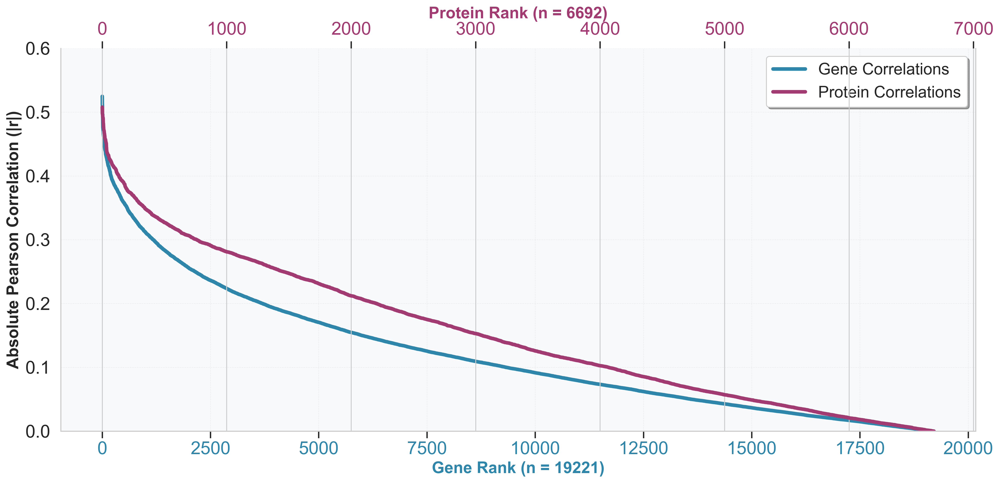

In [55]:
import matplotlib.pyplot as plt
import numpy as np

# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 16,
        "axes.titlesize": 18,
        "xtick.labelsize": 14,
        "ytick.labelsize": 14,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 8,
        "ytick.major.size": 8,
    }
)

# Create the figure with dual x-axes
fig, ax1 = plt.subplots(figsize=(16, 8))

# Plot gene correlations on primary x-axis (actual gene indices)
ax1.plot(
    range(len(corr_sorted)),
    corr_sorted["abs_pearson"].values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Correlations",
)
ax1.set_xlabel(
    "Gene Rank (n = {})".format(len(corr_sorted)),
    fontsize=18,
    fontweight="bold",
    color="#2E86AB",
)
ax1.set_ylabel("Absolute Pearson Correlation (|r|)", fontsize=18, fontweight="bold")
ax1.tick_params(axis="x", labelcolor="#2E86AB")

# Plot protein correlations on secondary x-axis (actual protein indices)
ax2 = ax1.twiny()
ax2.plot(
    range(len(corr_sorted_prot)),
    corr_sorted_prot["abs_pearson"].values,
    color="#A23B72",
    linewidth=4,
    label="Protein Correlations",
)
ax2.set_xlabel(
    "Protein Rank (n = {})".format(len(corr_sorted_prot)),
    fontsize=18,
    fontweight="bold",
    color="#A23B72",
)
ax2.tick_params(axis="x", labelcolor="#A23B72")

# Improve tick labels and grid
ax1.tick_params(axis="both", which="major", labelsize=20)
ax2.tick_params(axis="x", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Set y-axis limits
ax1.set_ylim(0, 0.6)  # Pearson correlation ranges from 0 to 1 for absolute values

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax1.spines["right"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=18,
    frameon=True,
    fancybox=True,
    shadow=True,
    loc="upper right",
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()


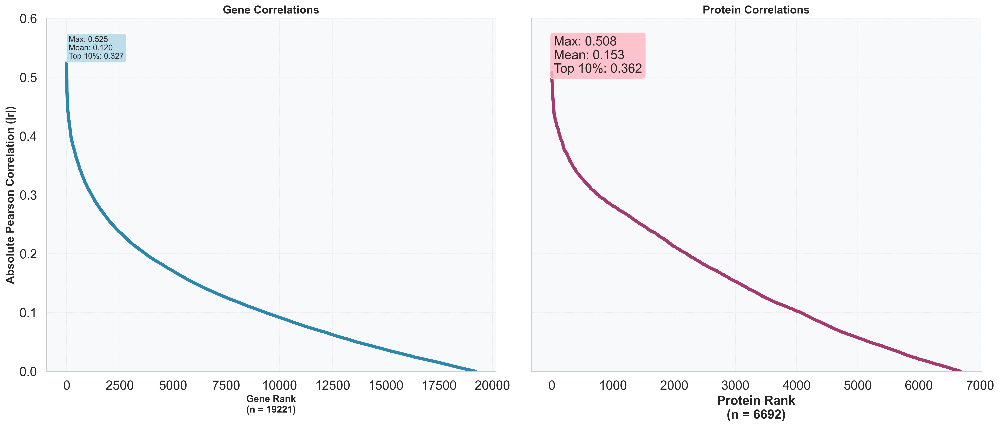

In [56]:
# Enhanced version with summary statistics
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8), sharey=True)

# Calculate summary statistics
gene_stats = {
    "max": corr_sorted["abs_pearson"].max(),
    "mean": corr_sorted["abs_pearson"].mean(),
    "top10_mean": corr_sorted["abs_pearson"].head(int(0.1 * len(corr_sorted))).mean(),
}

prot_stats = {
    "max": corr_sorted_prot["abs_pearson"].max(),
    "mean": corr_sorted_prot["abs_pearson"].mean(),
    "top10_mean": corr_sorted_prot["abs_pearson"]
    .head(int(0.1 * len(corr_sorted_prot)))
    .mean(),
}

# Plot gene correlations with annotations
ax1.plot(corr_sorted["abs_pearson"].values, color="#2E86AB", linewidth=4)
ax1.set_xlabel(
    "Gene Rank\n(n = {})".format(len(corr_sorted)), fontsize=12, fontweight="bold"
)
ax1.set_ylabel("Absolute Pearson Correlation (|r|)", fontsize=14, fontweight="bold")
ax1.set_title("Gene Correlations", fontsize=14, fontweight="bold")
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)
ax1.set_ylim(0, 0.6)

# Add statistical annotations
ax1.text(
    0.05,
    0.95,
    f"Max: {gene_stats['max']:.3f}\nMean: {gene_stats['mean']:.3f}\nTop 10%: {gene_stats['top10_mean']:.3f}",
    transform=ax1.transAxes,
    fontsize=10,
    verticalalignment="top",
    bbox=dict(boxstyle="round", facecolor="lightblue", alpha=0.8),
)

# Plot protein correlations with annotations
ax2.plot(corr_sorted_prot["abs_pearson"].values, color="#A23B72", linewidth=4)
ax2.set_xlabel(
    "Protein Rank\n(n = {})".format(len(corr_sorted_prot)),
    fontsize=16,
    fontweight="bold",
)
ax2.set_title("Protein Correlations", fontsize=14, fontweight="bold")
ax2.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)
ax2.set_ylim(0, 0.6)

# Add statistical annotations
ax2.text(
    0.05,
    0.95,
    f"Max: {prot_stats['max']:.3f}\nMean: {prot_stats['mean']:.3f}\nTop 10%: {prot_stats['top10_mean']:.3f}",
    transform=ax2.transAxes,
    fontsize=16,
    verticalalignment="top",
    bbox=dict(boxstyle="round", facecolor="lightpink", alpha=0.8),
)

# Remove spines for cleaner look
for ax in [ax1, ax2]:
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.set_facecolor("#f8f9fa")

# tick params need to be bigger 
ax1.tick_params(axis="both", which="major", labelsize=16)
ax2.tick_params(axis="both", which="major", labelsize=16)

plt.tight_layout()
plt.show()


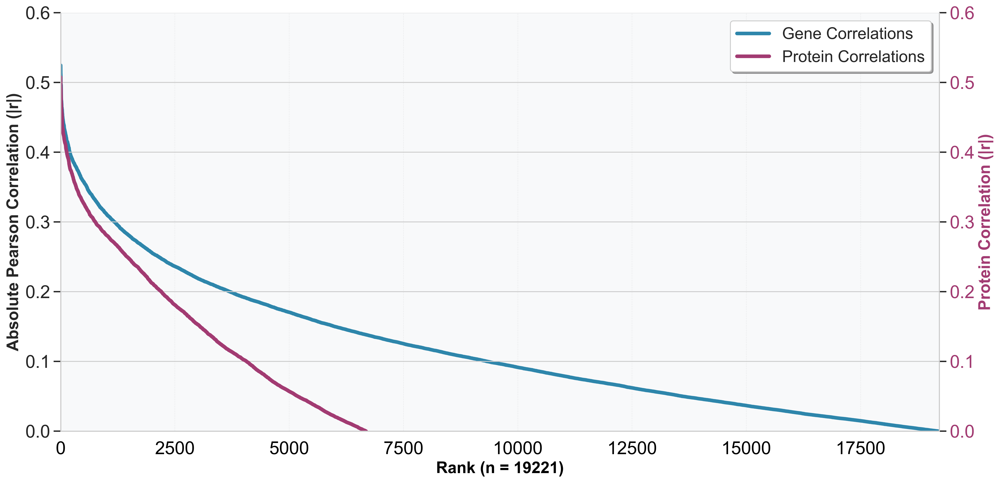

In [62]:
import matplotlib.pyplot as plt
import numpy as np

# Set journal-quality formatting
plt.rcParams.update(
    {
        "font.size": 24,
        "font.family": "sans",
        "font.serif": ["Arial"],
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "axes.linewidth": 1.2,
        "lines.linewidth": 3,
        "axes.labelsize": 16,
        "axes.titlesize": 18,
        "xtick.labelsize": 14,
        "ytick.labelsize": 14,
        "xtick.major.width": 1.5,
        "ytick.major.width": 1.5,
        "xtick.major.size": 8,
        "ytick.major.size": 8,
    }
)

# Ensure both datasets are sorted by correlation values (descending)
corr_sorted = corr_sorted.sort_values("abs_pearson", ascending=False).reset_index(
    drop=True
)
corr_sorted_prot = corr_sorted_prot.sort_values(
    "abs_pearson", ascending=False
).reset_index(drop=True)

# Create the figure with dual x-axes
fig, ax1 = plt.subplots(figsize=(16, 8))

# Plot gene correlations on primary x-axis
ax1.plot(
    range(len(corr_sorted)),
    corr_sorted["abs_pearson"].values,
    color="#2E86AB",
    linewidth=4,
    label="Gene Correlations",
)
ax1.set_xlabel(
    "Rank (n = {})".format(max(len(corr_sorted), len(corr_sorted_prot))),
    fontsize=18,
    fontweight="bold",
    color="black",  # Changed to black since both axes now share the same rank
)
ax1.set_ylabel("Absolute Pearson Correlation (|r|)", fontsize=18, fontweight="bold")
ax1.tick_params(axis="x", labelcolor="black")

# Plot protein correlations on secondary y-axis (since x-axis rank is now shared)
ax2 = ax1.twinx()  # Changed from twiny() to twinx()
ax2.plot(
    range(len(corr_sorted_prot)),
    corr_sorted_prot["abs_pearson"].values,
    color="#A23B72",
    linewidth=4,
    label="Protein Correlations",
)
ax2.set_ylabel(
    "Protein Correlation (|r|)", fontsize=18, fontweight="bold", color="#A23B72"
)
ax2.tick_params(axis="y", labelcolor="#A23B72")

# Set consistent x-axis limits for both datasets
max_rank = max(len(corr_sorted), len(corr_sorted_prot))
ax1.set_xlim(0, max_rank)

# Improve tick labels and grid
ax1.tick_params(axis="both", which="major", labelsize=20)
ax2.tick_params(axis="y", which="major", labelsize=20)
ax1.grid(True, alpha=0.3, linestyle="--", linewidth=0.5)

# Set y-axis limits
ax1.set_ylim(0, 0.6)
ax2.set_ylim(0, 0.6)  # Ensure both y-axes have the same scale

# Remove spines for cleaner look
ax1.spines["top"].set_visible(False)
ax2.spines["top"].set_visible(False)

# Add legend
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(
    lines1 + lines2,
    labels1 + labels2,
    fontsize=18,
    frameon=True,
    fancybox=True,
    shadow=True,
    loc="upper right",
)

# Add a subtle background
ax1.set_facecolor("#f8f9fa")

# Adjust layout
plt.tight_layout()
plt.show()
